# Example 4

This notebook generates events inside the MicroBooNE cryostat.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

import DarkNews as dn
from DarkNews import GenLauncher

import ToyAnalysis as ta

import ToyAnalysis.analysis as a
import ToyAnalysis.analysis_decay as an

#### We start by generating events for four benchmark points inside the MicroBooNE cryostat. 

In [3]:
kwargs = {  
        'neval': 1e4,
        'HNLtype': 'dirac',
        # 'hepevt': True,
        # 'unweighted_hep_events': 1000,
        # 'hep_unweight': True,
        'experiment': 'microboone',
        'nopelastic': True,
        'pandas': False,
        'loglevel': 'WARNING'
        }

gen_object = GenLauncher(mzprime=0.030, m4=0.150, **kwargs)
gen_object.run()
df1 = gen_object.df

gen_object = GenLauncher(mzprime=1.25, m4=0.150, **kwargs)
gen_object.run()
df2 = gen_object.df

gen_object = GenLauncher(mzprime=0.03, m5=0.150, m4=0.107, **kwargs)
gen_object.run()
df3 = gen_object.df

gen_object = GenLauncher(mzprime=1.25, m5=0.150, m4=0.107, **kwargs)
gen_object.run()
df4 = gen_object.df

Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.


In [4]:
events=dn.geom.microboone_geometry(df1)

In [6]:
# we get crazy numbers because we didn't set the couplings to reasonable values

print(f"Total upscattering events for BP1 {df1['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP2 {df2['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP3 {df3['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP4 {df4['w_event_rate'].sum():.2E}")

Total upscattering events for BP1 7.11E+05
Total upscattering events for BP2 3.66E+00
Total upscattering events for BP3 7.07E+05
Total upscattering events for BP4 4.02E+00


In [7]:
# we set some useful parameters and compute which events occur in the active detector of MicroBooNE

df1 = an.set_params(df1)
df2 = an.set_params(df2)
df3 = an.set_params(df3)
df4 = an.set_params(df4)

df1_decay = an.decay_selection(df1, l_decay_proper_cm = df1.attrs['N4_ctau0'], experiment='microboone')
df2_decay = an.decay_selection(df2, l_decay_proper_cm = df2.attrs['N4_ctau0'], experiment='microboone')
df3_decay = an.decay_selection(df3, l_decay_proper_cm = df3.attrs['N5_ctau0'], experiment='microboone')
df4_decay = an.decay_selection(df4, l_decay_proper_cm = df4.attrs['N5_ctau0'], experiment='microboone')

#### Looking at the geometry of the scattering positions: XY plane

/Users/user/miniconda3/envs/DarkNews310/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


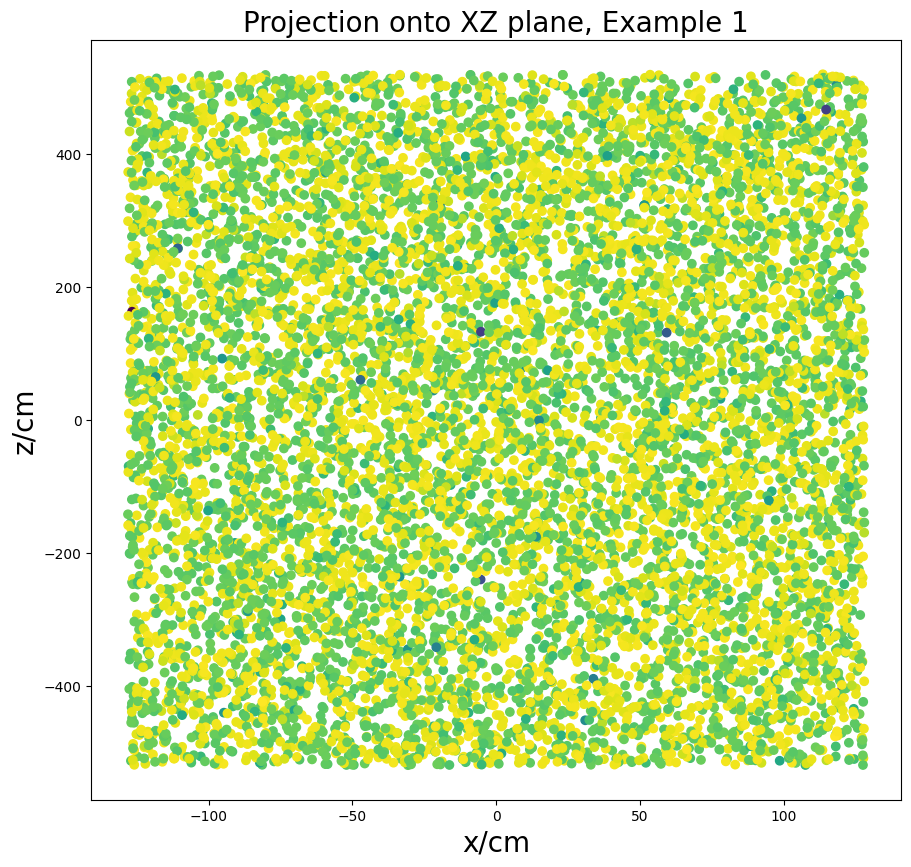

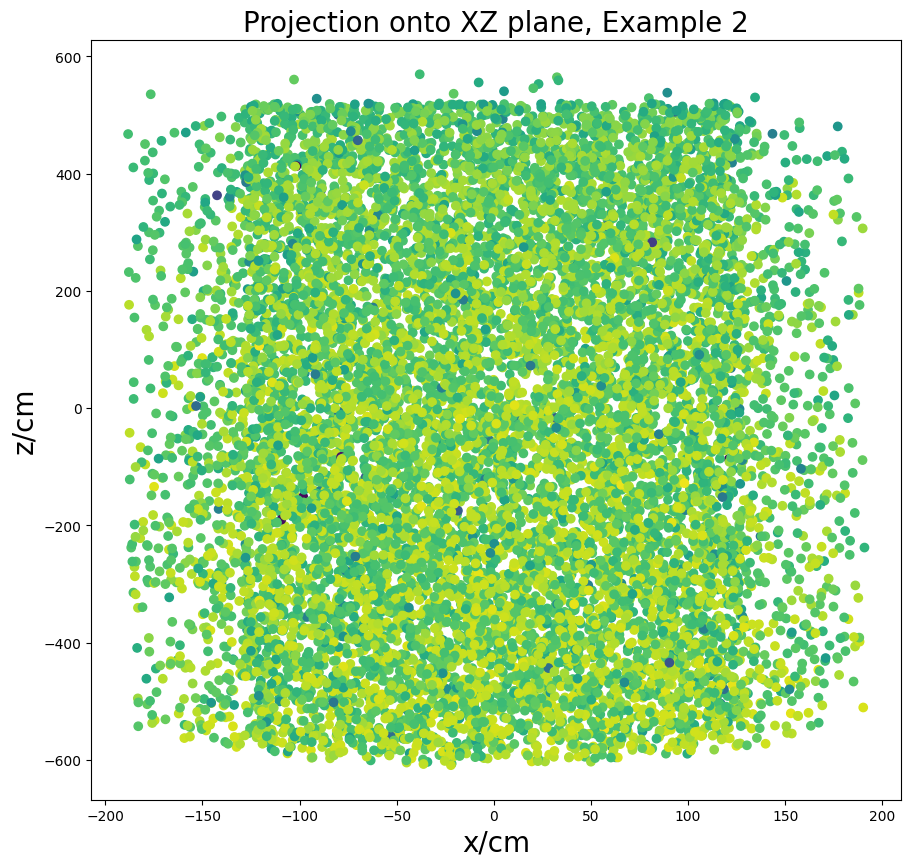

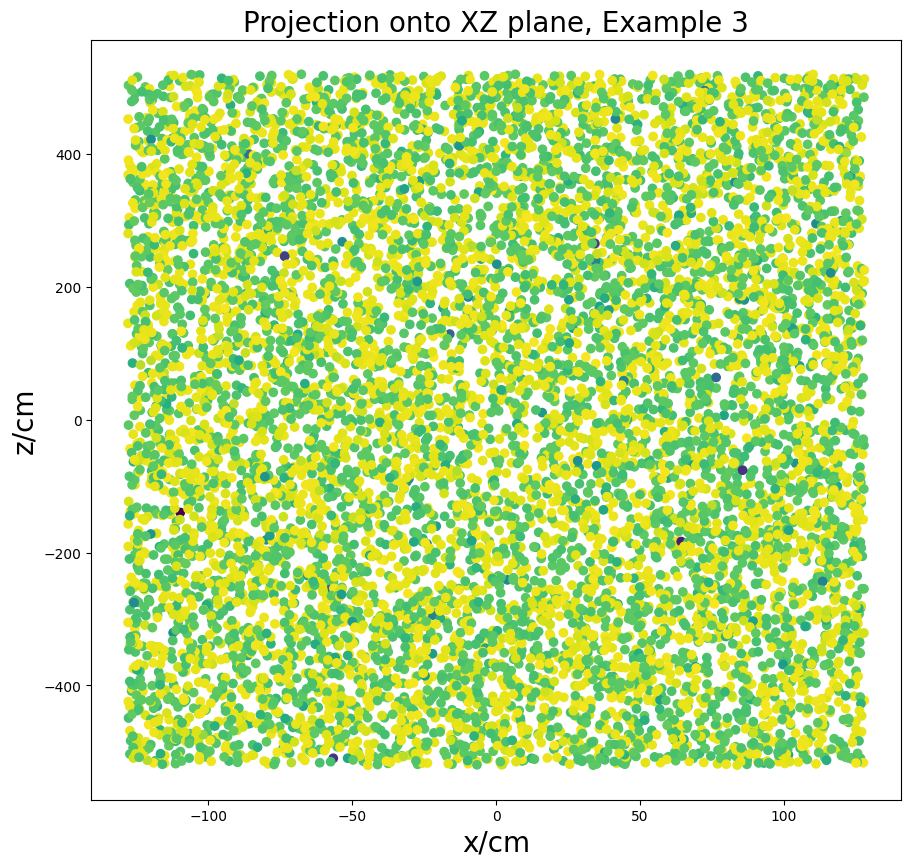

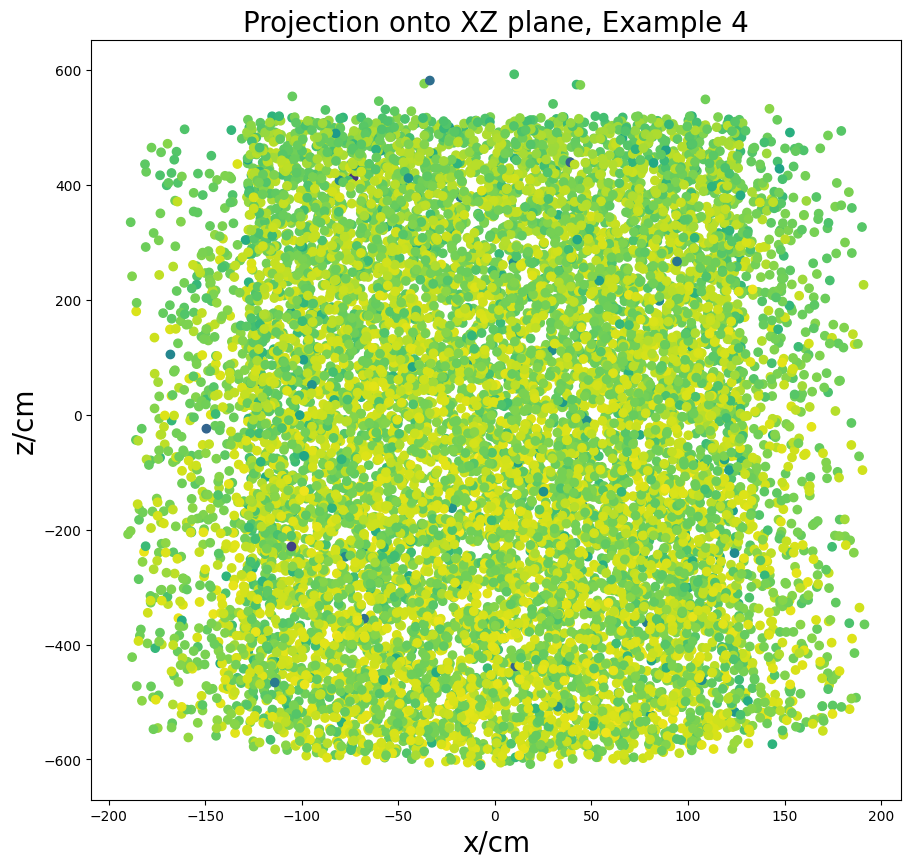

In [8]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto XZ plane, Example " + bp
    xlabel = r'x/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    plt.scatter(df_scat['pos_scatt','1'], df_scat['pos_scatt','3'], c=np.log10(df_scat['w_event_rate']))
    ax.set_title(title,   fontsize=20)
    ax.set_xlabel(xlabel, fontsize=20)
    ax.set_ylabel(ylabel, fontsize=20)

In [9]:
df_scat.columns.levels[0]

Index(['P_decay_N_daughter', 'P_decay_N_parent', 'P_decay_ell_minus',
       'P_decay_ell_plus', 'P_projectile', 'P_recoil', 'P_target',
       'w_decay_rate_0', 'w_event_rate', 'target_pdgid', 'projectile_pdgid',
       'w_flux_avg_xsec', 'target', 'scattering_regime', 'helicity',
       'underlying_process', 'h_projectile', 'h_parent', 'pos_scatt',
       'pos_prod', 'pos_decay', 'reco_theta_beam', 'reco_Evis', 'reco_w',
       'reco_Enu', 'w_pre_decay'],
      dtype='object')

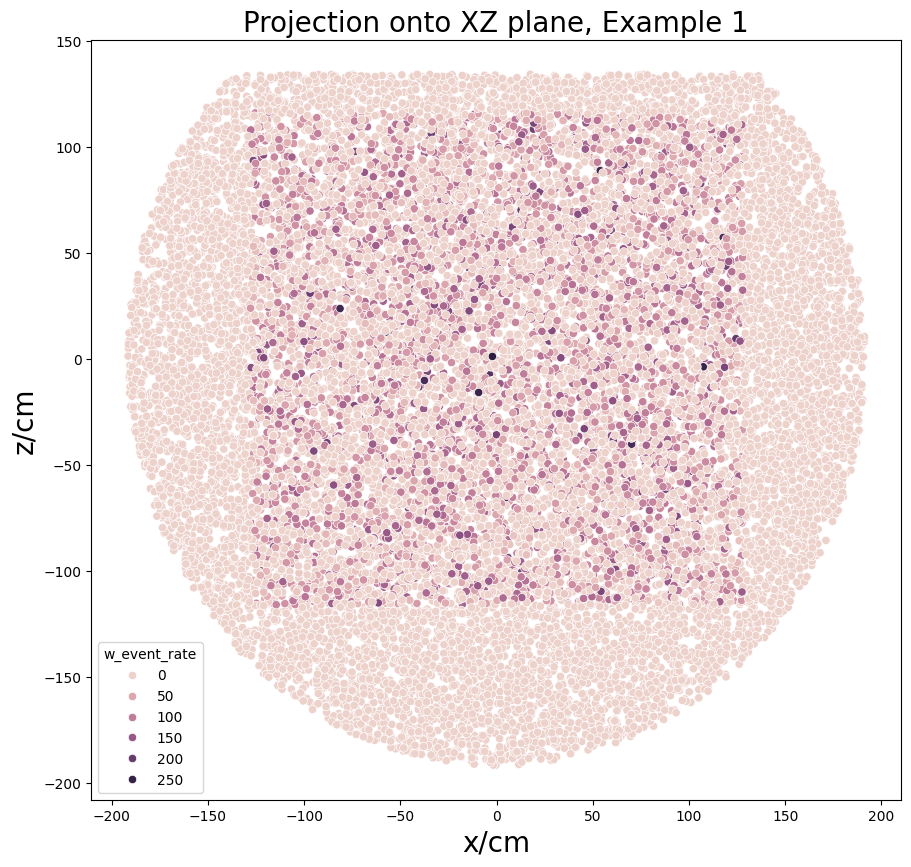

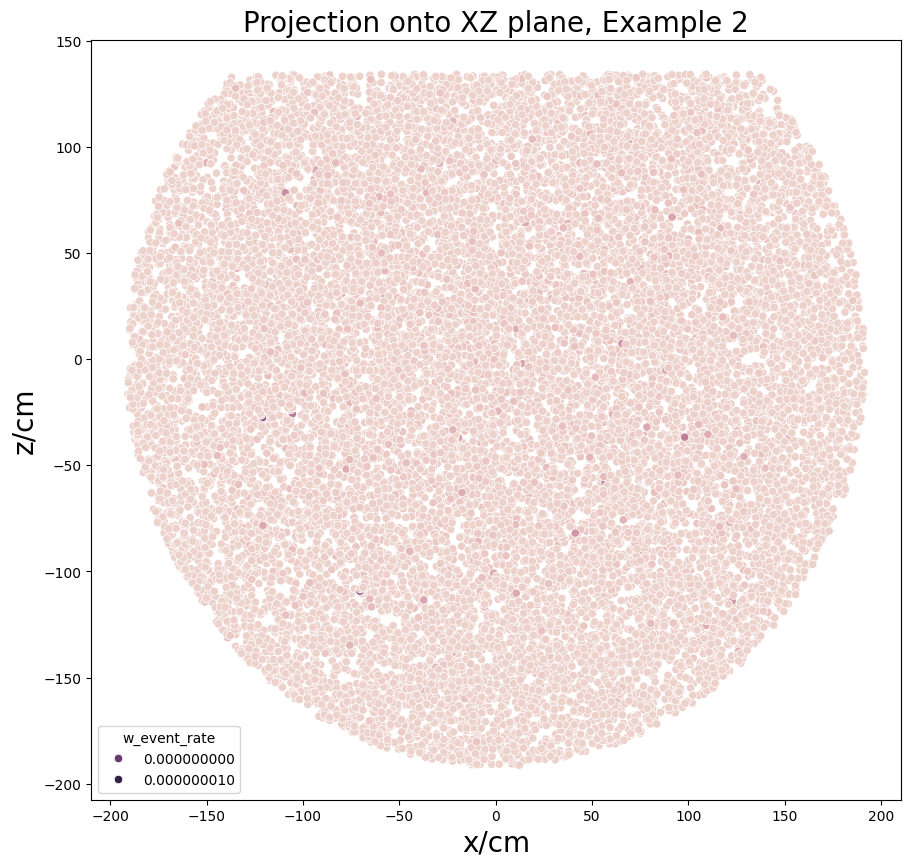

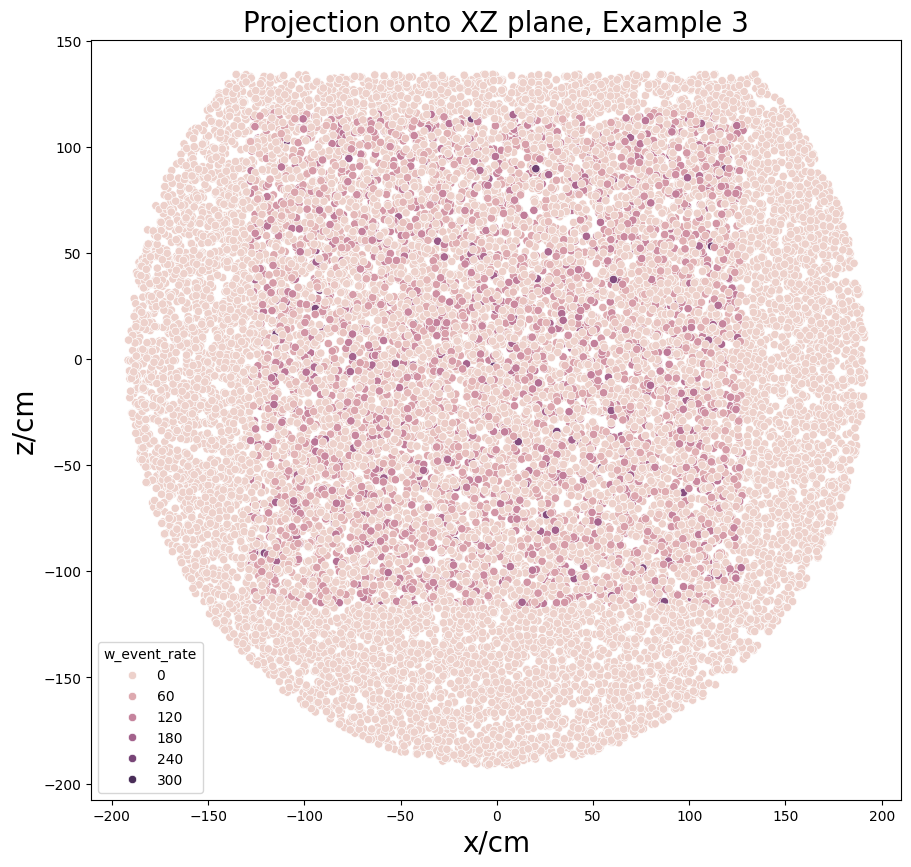

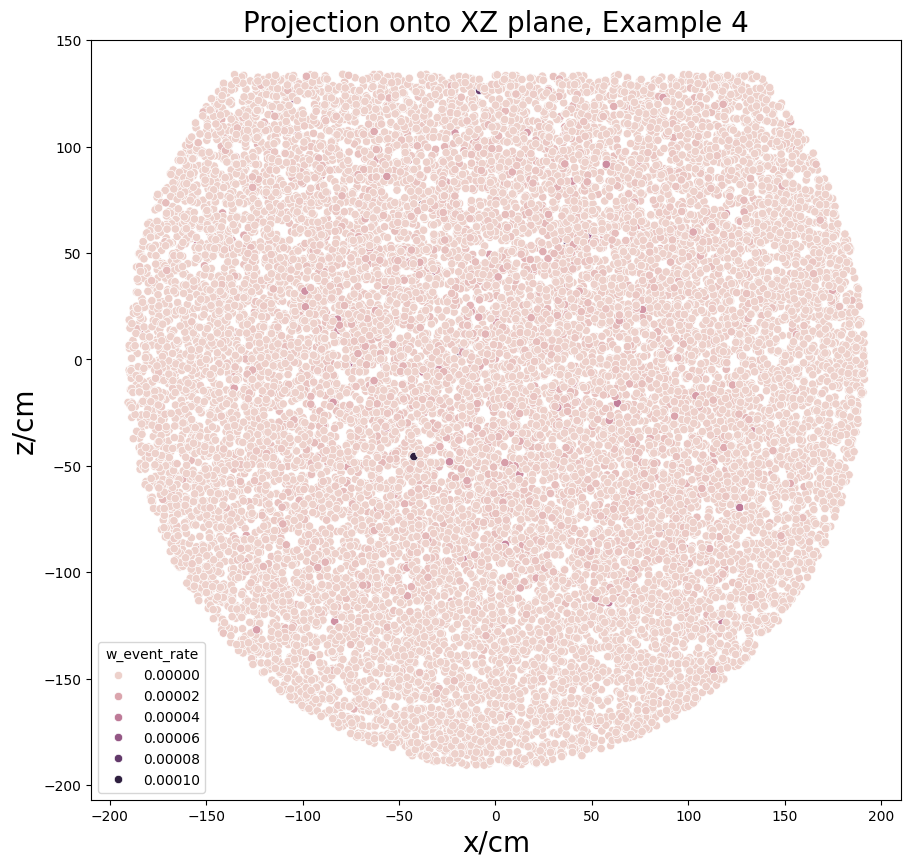

In [12]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto XZ plane, Example " + bp
    xlabel = r'x/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)

    sns.scatterplot(df_scat, x= ('pos_scatt','1'), y=('pos_scatt','2'), hue=('w_event_rate')) #['pos_scatt', '1'], df_scat['pos_scatt', '3'], hue=df_scat['w_event_rate'])
    ax.set_title(title,   fontsize=20)
    ax.set_xlabel(xlabel, fontsize=20)
    ax.set_ylabel(ylabel, fontsize=20)

#### Looking at the geometry of the scattering positions: YZ plane

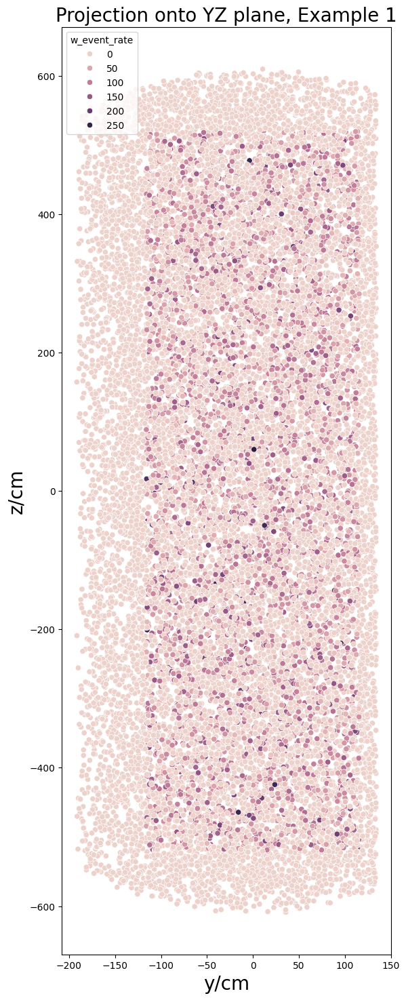

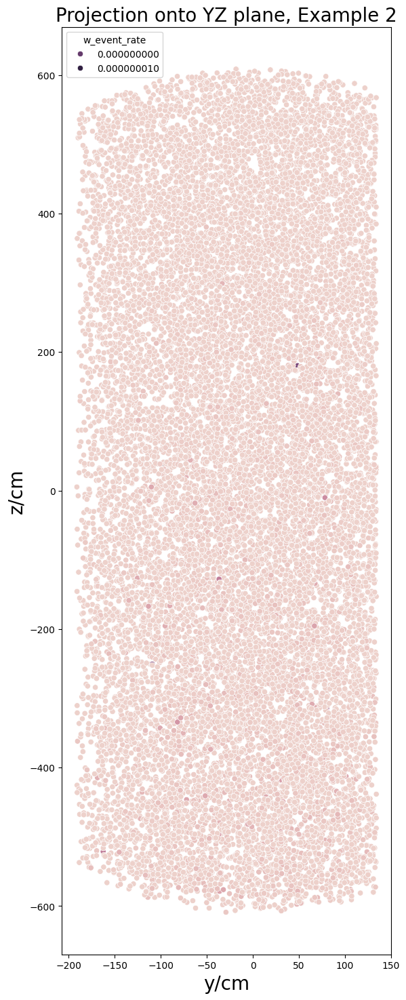

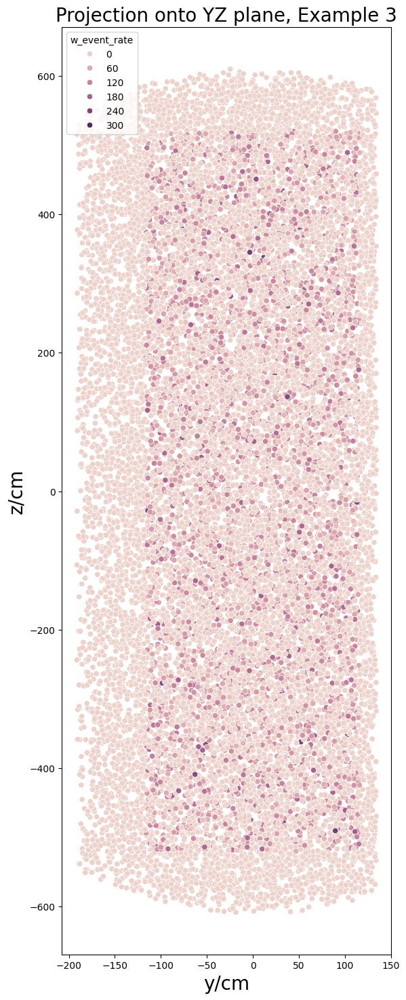

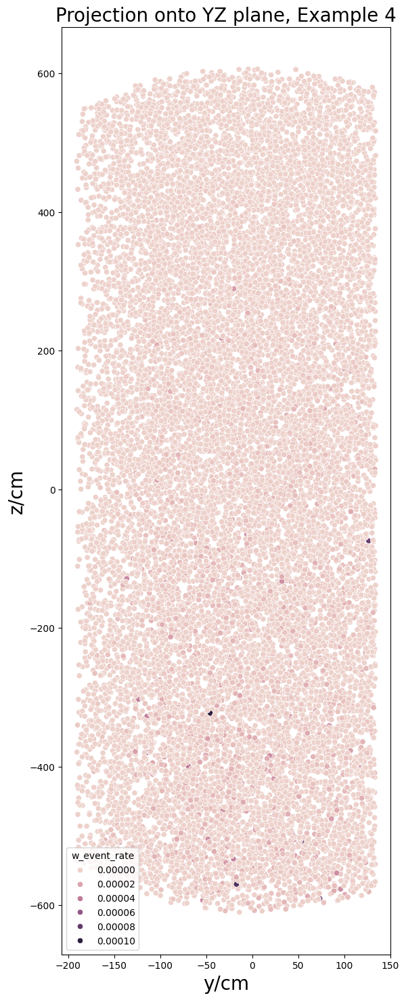

In [16]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto YZ plane, Example " + bp
    xlabel = r'y/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(6,18))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    
    sns.scatterplot(df_scat, x=('pos_scatt', '2'), y=('pos_scatt', '3'), hue=('w_event_rate'))    
    
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)

## Decay position

Considering points with a short and very long lifetimes.

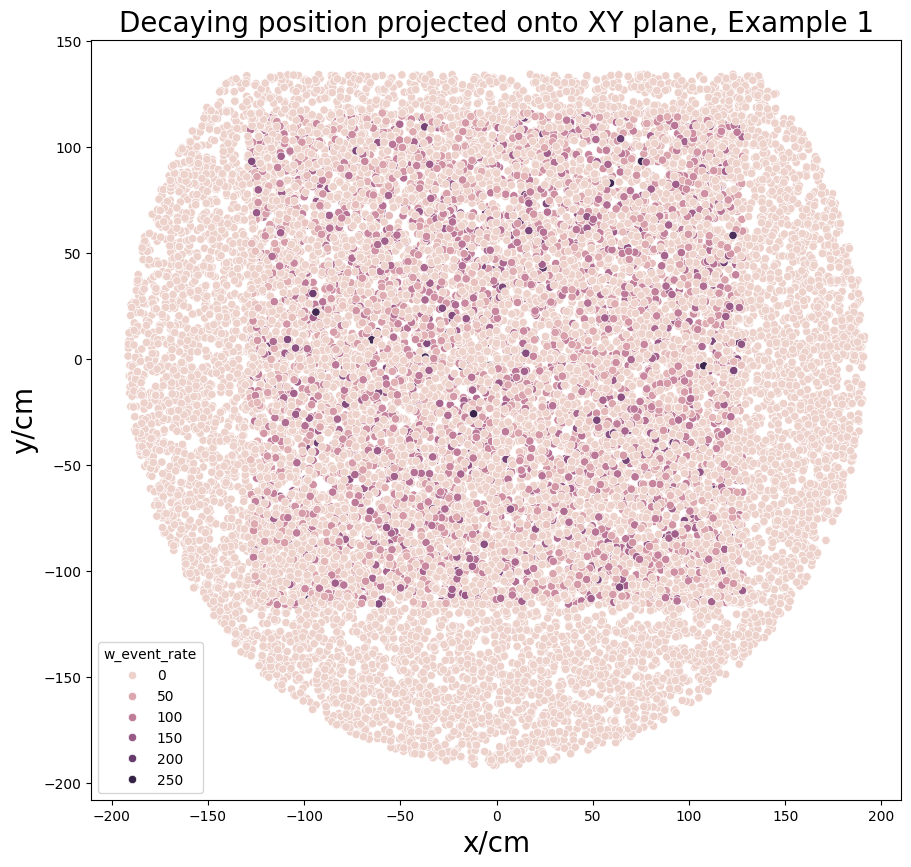

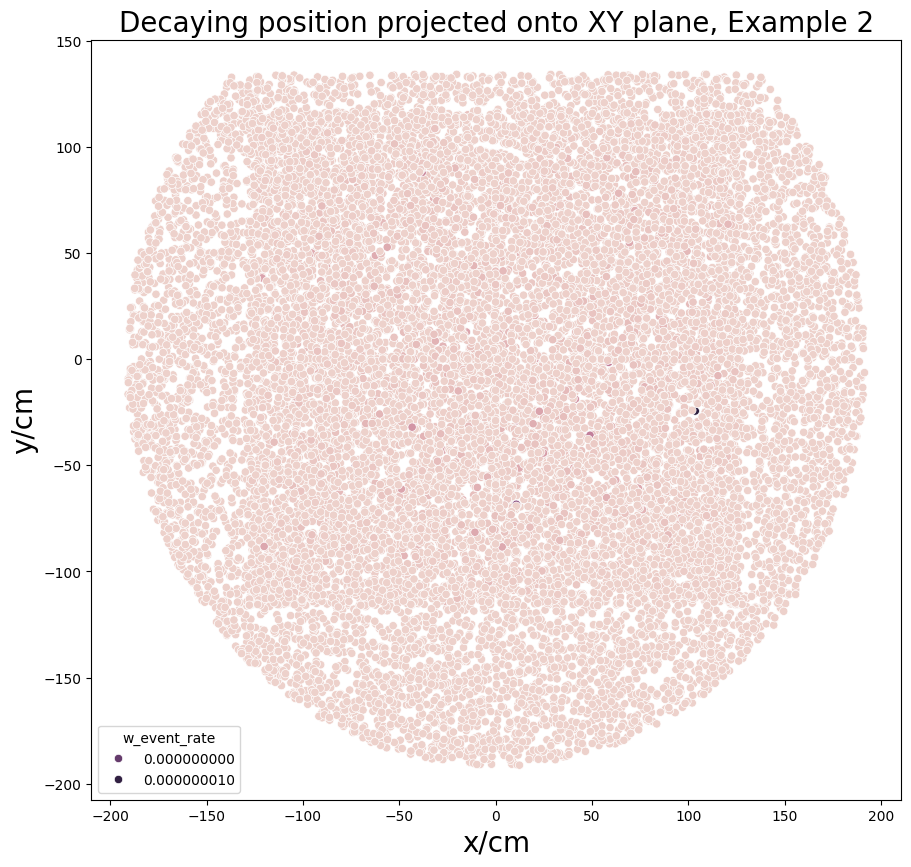

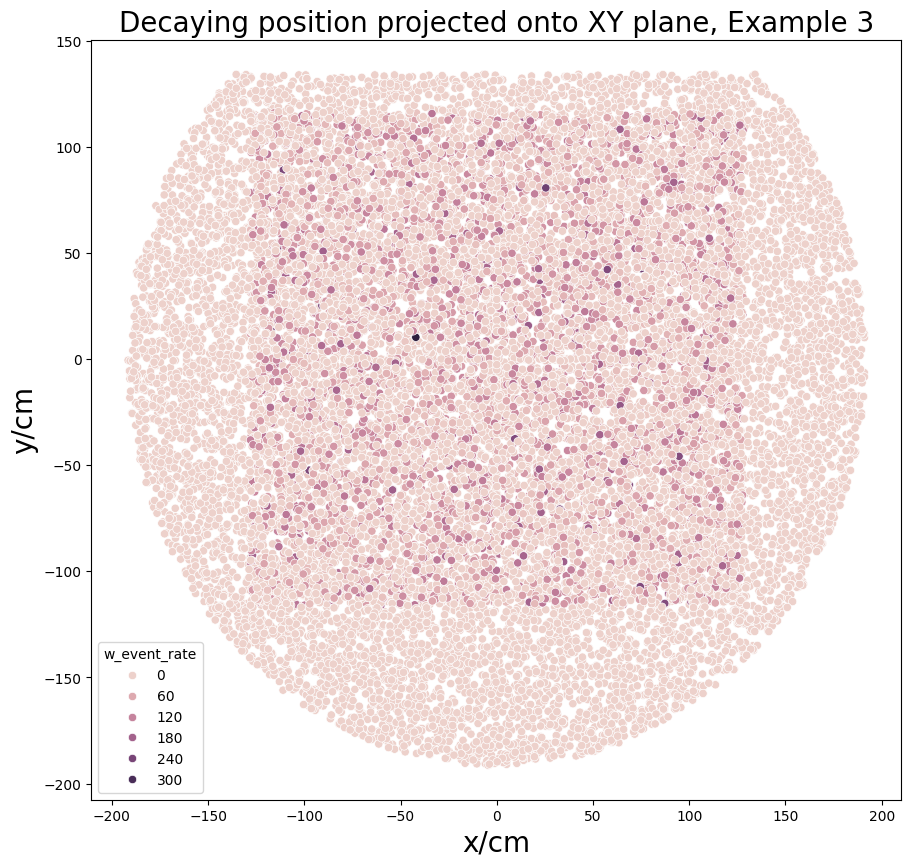

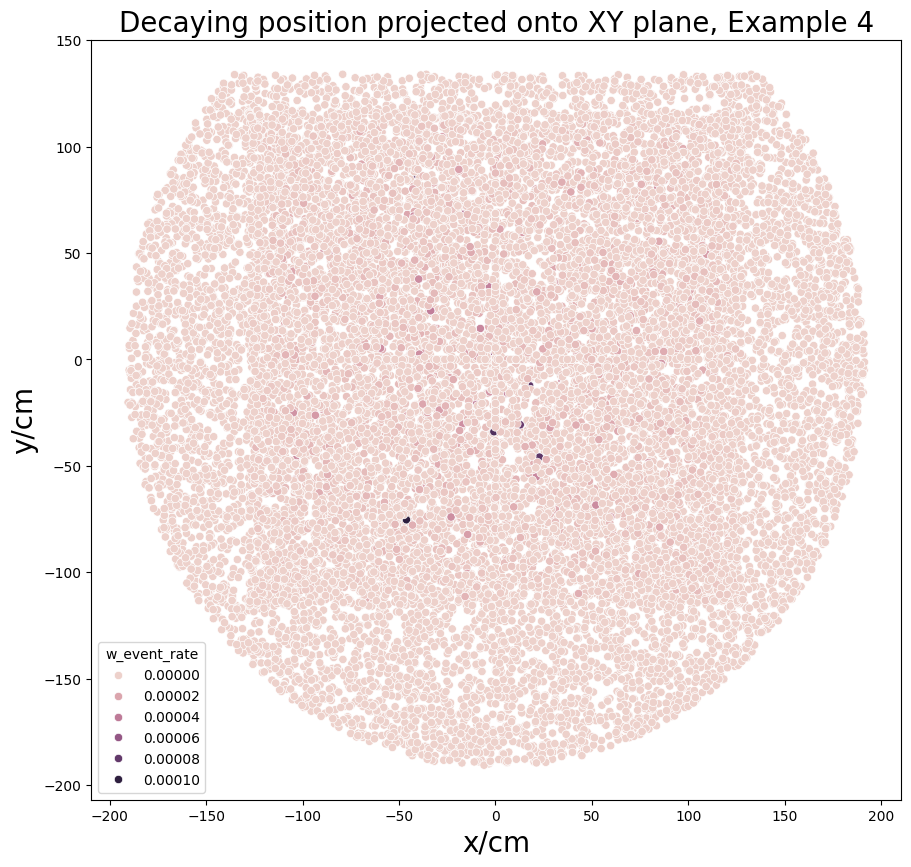

In [17]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Decaying position projected onto XY plane, Example "+bp
    xlabel = r'x/cm'
    ylabel = r'y/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    sns.scatterplot(df_scat, x=('pos_decay', '1'), y=('pos_decay', '2'), hue=('w_event_rate'))
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)

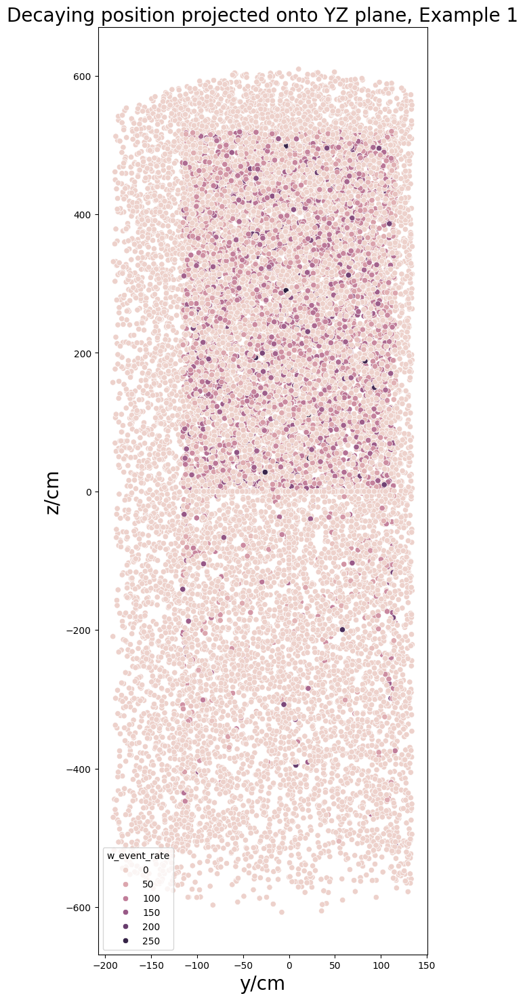

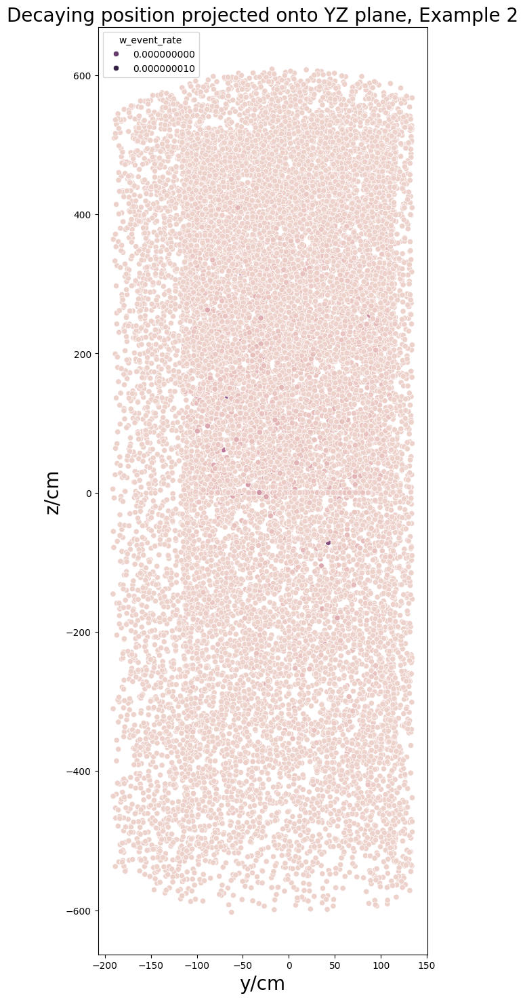

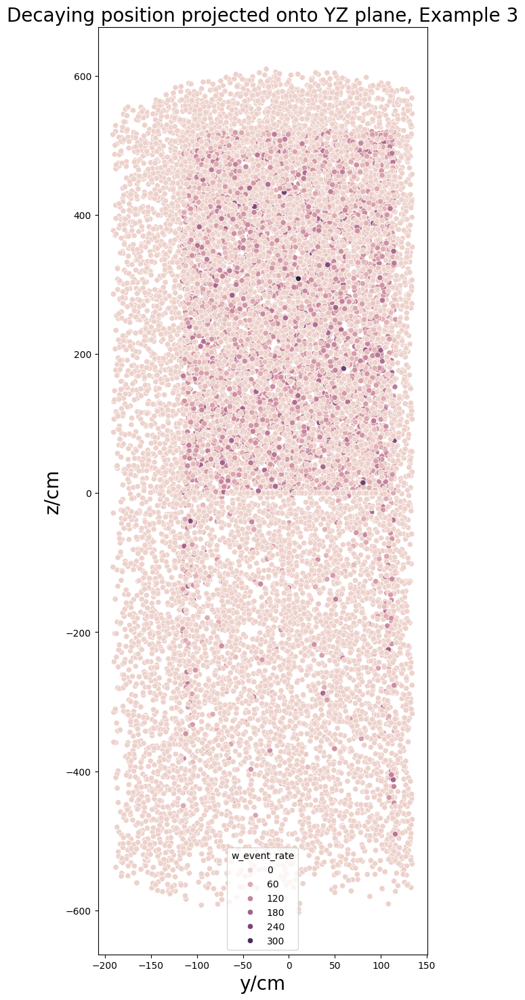

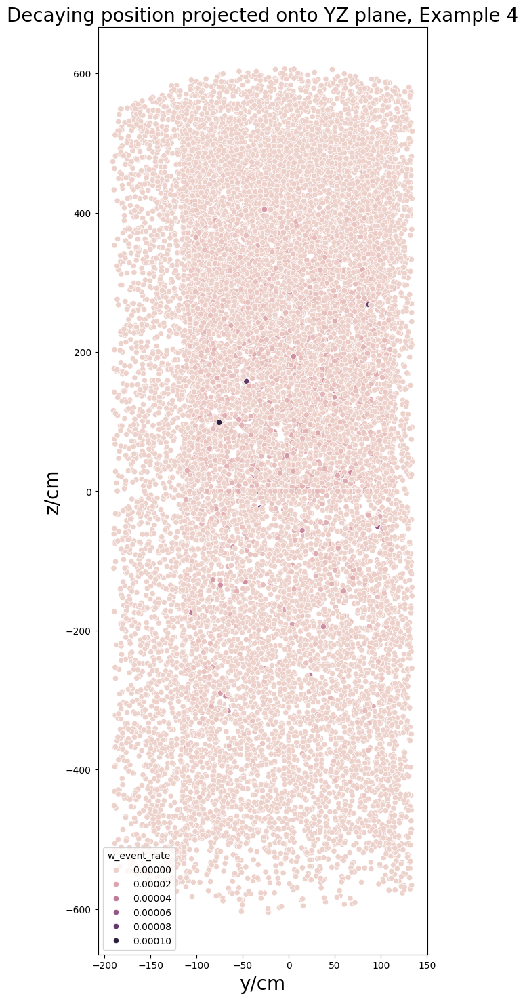

In [19]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Decaying position projected onto YZ plane, Example "+bp
    xlabel = r'y/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(6,18))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    sns.scatterplot(df_scat, x=('pos_decay', '2'), y=('pos_decay', '3'), hue=('w_event_rate')) 
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)